
<center>
El desafío que enfrentamos en este proyecto es desarrollar un modelo de aprendizaje automático para la clasificación de imágenes de hojas de plantas, con el objetivo de identificar si una planta está sana o enferma, y en caso de que esté enferma, determinar cuál es la enfermedad específica que la afecta. Este es un problema de clasificación multiclase, dado que nuestro dataset cuenta con 38 clases únicas que representan diferentes especies de plantas y sus posibles condiciones de salud.

Nuestro conjunto de datos consta de aproximadamente 87,000 imágenes de hojas en diversas condiciones. Las imágenes han sido preprocesadas y etiquetadas con su respectiva clase, proporcionándonos una fuente rica de datos para el entrenamiento y la validación de nuestro modelo.

Nuestra intención es construir un modelo de clasificación basado en la arquitectura MobileNet preentrenada. MobileNet es una arquitectura de red neuronal convolucional eficiente, diseñada específicamente para aplicaciones móviles y embebidas. Al utilizar un modelo preentrenado en el conjunto de datos de ImageNet, podemos beneficiarnos de la transferencia de aprendizaje, ahorrando tiempo y recursos de cómputo en comparación con el entrenamiento de un modelo desde cero.
</center>


El conjunto de datos contiene las siguientes categorías de plantas y sus respectivas enfermedades:

## 1. Manzana
- `Apple_scab`: Manzana con sarna
- `Apple_black_rot`: Manzana con podredumbre negra
- `Apple_cedar_apple_rust`: Manzana con roya del cedro
- `Apple_healthy`: Manzana saludable

## 2. Fondo sin hojas
- `Background_without_leaves`

## 3. Arándano
- `Blueberry_healthy`: Arándano saludable

## 4. Cereza
- `Cherry_powdery_mildew`: Cereza con oidio
- `Cherry_healthy`: Cereza saludable

## 5. Maíz
- `Corn_gray_leaf_spot`: Maíz con mancha gris en la hoja
- `Corn_common_rust`: Maíz con roya común
- `Corn_northern_leaf_blight`: Maíz con tizón foliar del norte
- `Corn_healthy`: Maíz saludable

## 6. Uva
- `Grape_black_rot`: Uva con podredumbre negra
- `Grape_black_measles`: Uva con sarampión negro
- `Grape_leaf_blight`: Uva con mancha de la hoja
- `Grape_healthy`: Uva saludable

## 7. Naranja
- `Orange_haunglongbing`: Naranja con Huanglongbing (HLB)

## 8. Durazno
- `Peach_bacterial_spot`: Durazno con mancha bacteriana
- `Peach_healthy`: Durazno saludable

## 9. Pimiento
- `Pepper_bacterial_spot`: Pimiento con mancha bacteriana
- `Pepper_healthy`: Pimiento saludable

## 10. Patata
- `Potato_early_blight`: Patata con tizón temprano
- `Potato_late_blight`: Patata con tizón tardío
- `Potato_healthy`: Patata saludable

## 11. Frambuesa
- `Raspberry_healthy`: Frambuesa saludable

## 12. Soja
- `Soybean_healthy`: Soja saludable

## 13. Calabaza
- `Squash_powdery_mildew`: Calabaza con oidio

## 14. Fresa
- `Strawberry_leaf_scorch`: Fresa con escaldadura de la hoja
- `Strawberry_healthy`: Fresa saludable

## 15. Tomate
- `Tomato_bacterial_spot`: Tomate con mancha bacteriana
- `Tomato_early_blight`: Tomate con tizón temprano
- `Tomato_late_blight`: Tomate con tizón tardío
- `Tomato_leaf_mold`: Tomate con moho foliar
- `Tomato_septoria_leaf_spot`: Tomato con mancha foliar por Septoria
- `Tomato_spider_mites_two-spotted_spider_mite`: Tomate con ácaros rojos / ácaros de dos manchas
- `Tomato_target_spot`: Tomate con mancha objetiva
- `Tomato_mosaic_virus`: Tomate con virus del mosaico del tomate
- `Tomato_yellow_leaf_curl_virus`: Tomate con virus del rizado amarillo de la hoja del tomate
- `Tomato_healthy`: Tomate saludable

Cada una de estas categorías es única y representa una clase específica para la cual nuestro modelo de aprendizaje automático será entrenado para identificar.



In [4]:
from google.colab import drive
drive.mount ('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Preprocesamiento

In [5]:
from zipfile import ZipFile

zip_path = "/content/drive/MyDrive/Data for Identification of Plant Leaf Diseases Using a 9-layer Deep Convolutional Neural Network.zip"

with ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall("/content")

print("Archivo descomprimido.")

Archivo descomprimido.


In [6]:
zip_path1 = "/content/Data for Identification of Plant Leaf Diseases Using a 9-layer Deep Convolutional Neural Network/Plant_leaf_diseases_dataset_with_augmentation.zip"
zip_path2 = "/content/Data for Identification of Plant Leaf Diseases Using a 9-layer Deep Convolutional Neural Network/Plant_leaf_diseases_dataset_without_augmentation.zip"

In [7]:
with ZipFile(zip_path1, 'r') as zip_ref:
    zip_ref.extractall("/content")

with ZipFile(zip_path2, 'r') as zip_ref:
    zip_ref.extractall("/content")

print("Archivo descomprimido.")


Archivo descomprimido.


In [2]:
import os
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


In [8]:
data_dir_aug = "/content/Plant_leave_diseases_dataset_with_augmentation"
data_dir_no_aug = "/content/Plant_leave_diseases_dataset_without_augmentation"
categories_aug = os.listdir(data_dir_aug)
categories_no_aug = os.listdir(data_dir_no_aug)

In [9]:
categories_aug

['Apple___Cedar_apple_rust',
 'Peach___Bacterial_spot',
 'Corn___healthy',
 'Tomato___Early_blight',
 'Grape___Black_rot',
 'Tomato___Bacterial_spot',
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
 'Blueberry___healthy',
 'Background_without_leaves',
 'Corn___Northern_Leaf_Blight',
 'Cherry___Powdery_mildew',
 'Tomato___Tomato_mosaic_virus',
 'Squash___Powdery_mildew',
 'Corn___Common_rust',
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 'Orange___Haunglongbing_(Citrus_greening)',
 'Apple___Black_rot',
 'Potato___Late_blight',
 'Peach___healthy',
 'Cherry___healthy',
 'Strawberry___healthy',
 'Apple___Apple_scab',
 'Grape___Esca_(Black_Measles)',
 'Pepper,_bell___Bacterial_spot',
 'Strawberry___Leaf_scorch',
 'Corn___Cercospora_leaf_spot Gray_leaf_spot',
 'Tomato___Leaf_Mold',
 'Tomato___Spider_mites Two-spotted_spider_mite',
 'Grape___healthy',
 'Tomato___healthy',
 'Tomato___Late_blight',
 'Apple___healthy',
 'Tomato___Target_Spot',
 'Potato___Early_blight',
 'Pepper,_bell___healthy',


Dataset with augmentation:


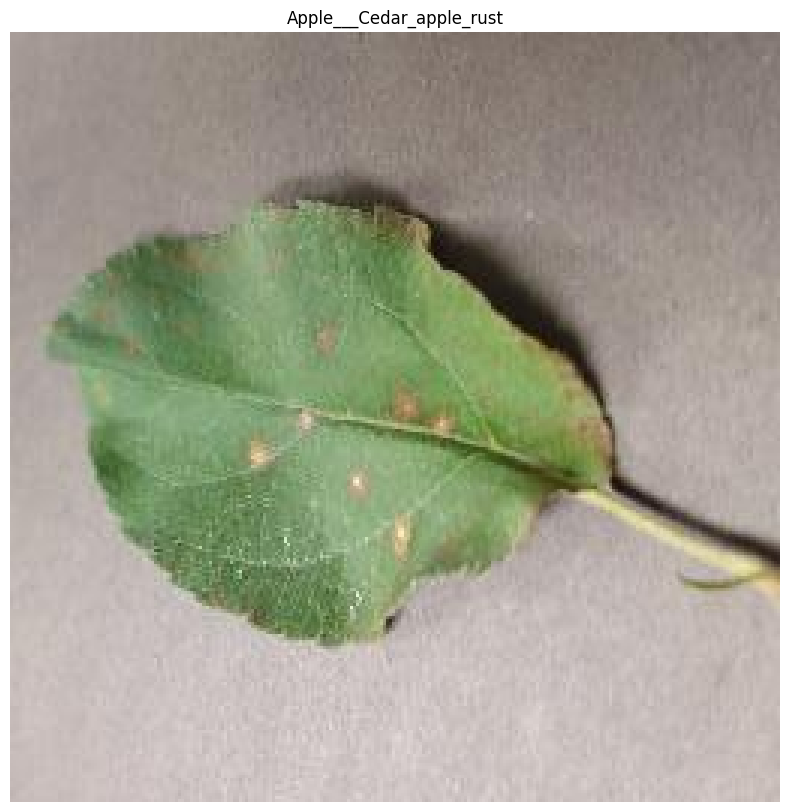

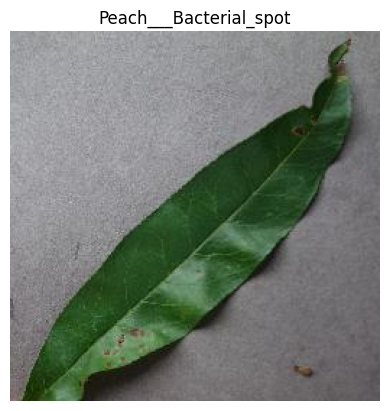

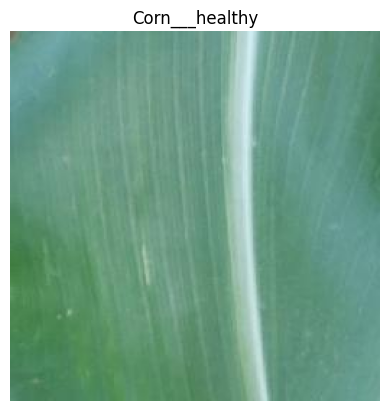

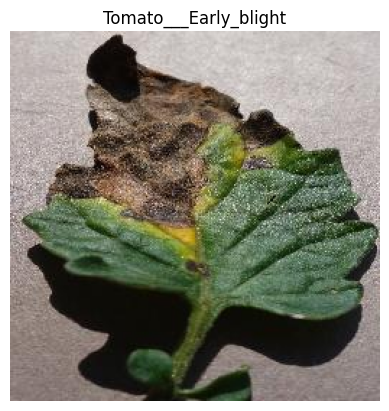

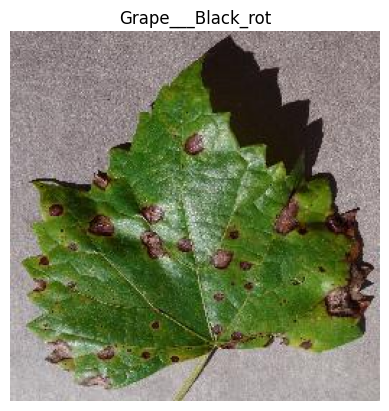

...

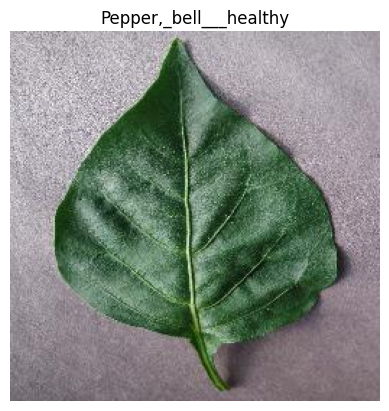

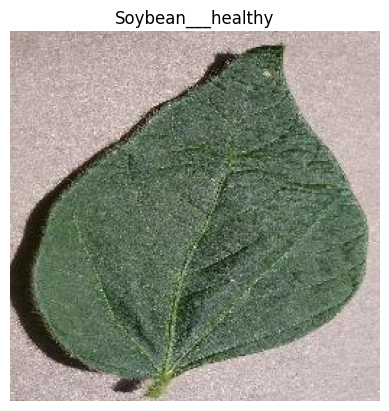

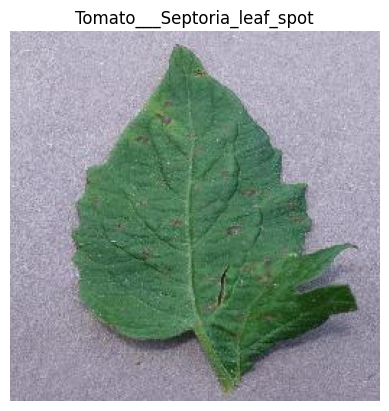

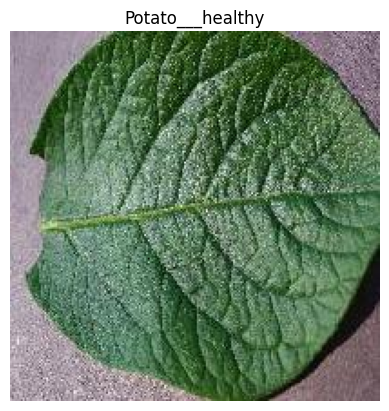

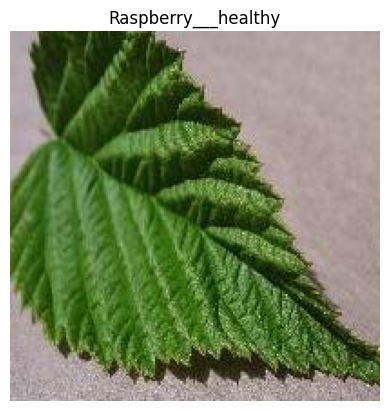

Dataset without augmentation:


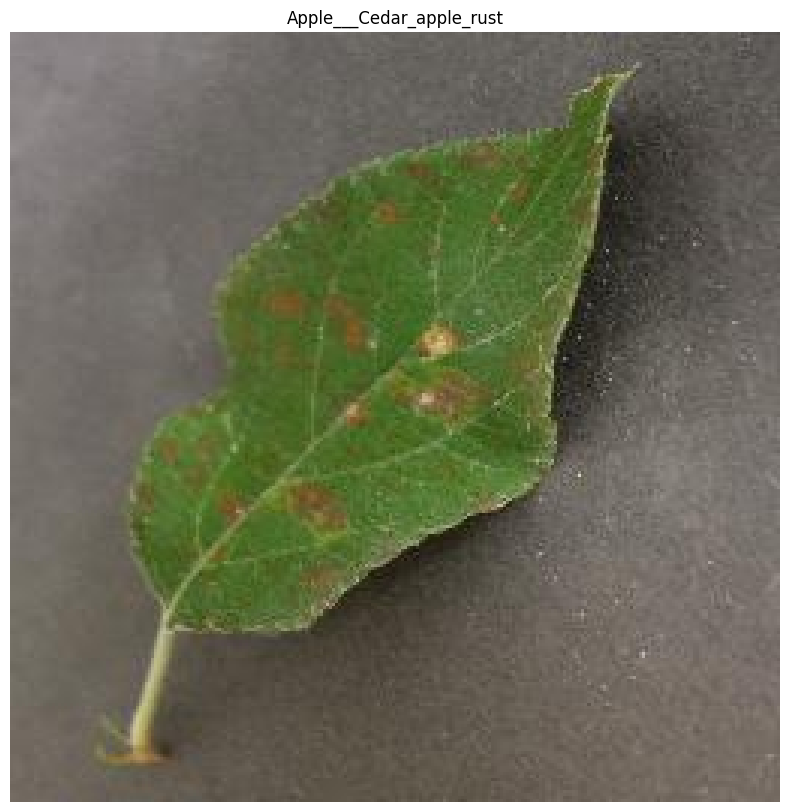

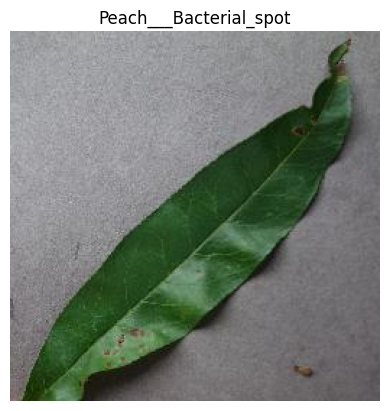

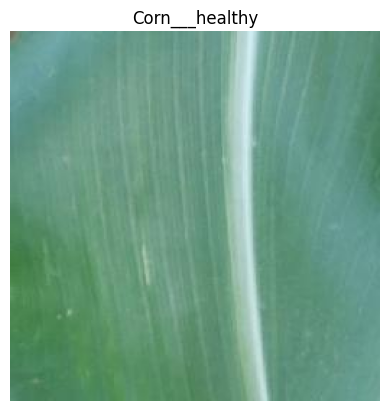

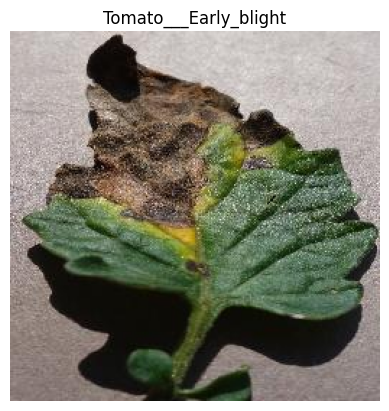

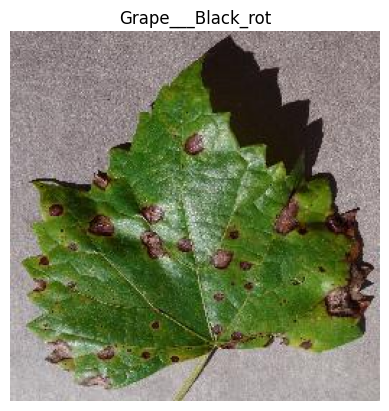

...

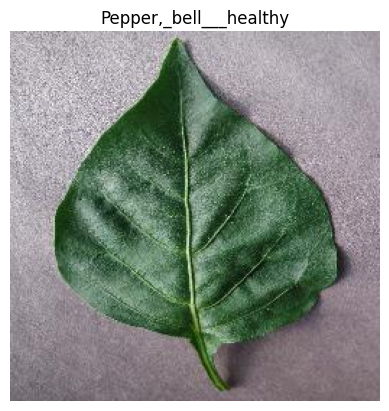

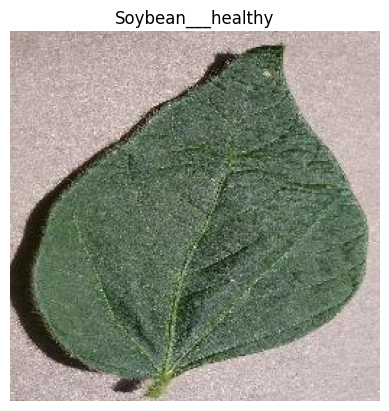

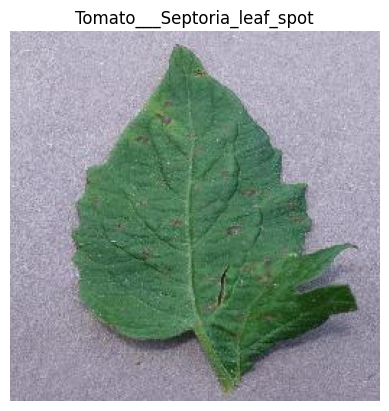

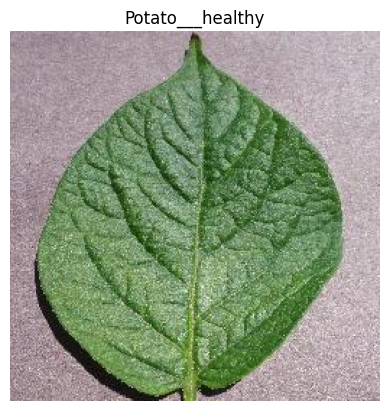

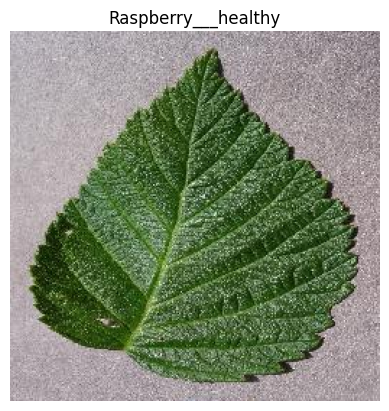

In [10]:
def plot_sample_images(categories, data_dir):
    plt.figure(figsize=(10, 10))
    for category in categories:
        imgs = glob.glob(os.path.join(data_dir, category, '*.[jJ][pP][gG]'))
        if len(imgs) > 0:
            img = mpimg.imread(imgs[0])
            plt.imshow(img)
            plt.title(category)
            plt.axis('off')
            plt.show()
        else:
            print(f"No se encontraron imágenes en la categoría: {category}")


print("Dataset with augmentation:")
plot_sample_images(categories_aug, data_dir_aug)
print("Dataset without augmentation:")
plot_sample_images(categories_no_aug, data_dir_no_aug)

In [ ]:
!pip install tensorflow

## Etiquetas y categorías

In [11]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.utils import to_categorical
import numpy as np

In [12]:
def get_images_and_labels(data_dir, categories):
    images = []
    labels = []
    for category in categories:
        imgs = glob.glob(os.path.join(data_dir, category, '*.[jJ][pP][gG]'))
        for img in imgs:
            images.append(img)
            labels.append(category)
    return images, labels

In [13]:
images_aug, labels_aug = get_images_and_labels(data_dir_aug, categories_aug)

In [14]:
encoder = LabelEncoder()
labels_aug = encoder.fit_transform(labels_aug)

In [15]:
labels_aug

array([ 2,  2,  2, ..., 24, 24, 24])

## Imagen

In [16]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [17]:
BATCH_SIZE = 32
IMG_SIZE = 224

In [18]:
datagen = ImageDataGenerator(validation_split=0.2,rescale= 1./255)

In [19]:
#Generador para los datos de entrenamiento (El objetivo de esta técnica es no colapsar la memoria ram por el alto contenido de imágenes a procesar)
train_gen = datagen.flow_from_directory(
    data_dir_aug,
    target_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE,
    subset='training',
    class_mode='categorical')

#Generador para los datos de validación
val_gen = datagen.flow_from_directory(
    data_dir_aug,
    target_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE,
    subset='validation',
    class_mode='categorical')

Found 49197 images belonging to 39 classes.
Found 12289 images belonging to 39 classes.


## Modelado

In [20]:
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D

In [21]:
num_classes = len(categories_aug)

## Descarga de modelo

In [22]:
base_model = MobileNetV2(input_shape=(IMG_SIZE, IMG_SIZE, 3), include_top=False, weights='imagenet')

9406464/9406464 [==============================] - 0s 0us/step


In [23]:
#Congelamos las capas del modelo
base_model.trainable = False

In [24]:
model = Sequential([
    base_model,
    GlobalAveragePooling2D(),
    Dense(num_classes, activation = "softmax")])

In [25]:
model.compile(optimizer='adam',loss="categorical_crossentropy", metrics=["accuracy"])

In [26]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 mobilenetv2_1.00_224 (Func  (None, 7, 7, 1280)        2257984   
 tional)                                                         
                                                                 
 global_average_pooling2d (  (None, 1280)              0         
 GlobalAveragePooling2D)                                         
                                                                 
 dense (Dense)               (None, 39)                49959     
                                                                 
Total params: 2307943 (8.80 MB)
Trainable params: 49959 (195.15 KB)
Non-trainable params: 2257984 (8.61 MB)
_________________________________________________________________


## Entrenamiento

In [27]:
from tensorflow.keras.callbacks import EarlyStopping

EPOCHS = 50
early_stop = EarlyStopping(monitor='val_loss', patience=3, verbose=1, restore_best_weights=True)

history = model.fit_generator(
    train_gen,
    validation_data=val_gen,
    epochs=EPOCHS,
    callbacks=[early_stop]
)

<ipython-input-27-b9905794998e>:6: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(


Epoch 1/50
1538/1538 [==============================] - 2349s 2s/step - loss: 0.4004 - accuracy: 0.8950 - val_loss: 0.2200 - val_accuracy: 0.9387
Epoch 2/50
1538/1538 [==============================] - 2370s 2s/step - loss: 0.1495 - accuracy: 0.9558 - val_loss: 0.1676 - val_accuracy: 0.9482
Epoch 3/50
1538/1538 [==============================] - 2442s 2s/step - loss: 0.1061 - accuracy: 0.9673 - val_loss: 0.1476 - val_accuracy: 0.9530
Epoch 4/50
1538/1538 [==============================] - 2428s 2s/step - loss: 0.0859 - accuracy: 0.9735 - val_loss: 0.1697 - val_accuracy: 0.9468
Epoch 5/50
1538/1538 [==============================] - 2396s 2s/step - loss: 0.0701 - accuracy: 0.9791 - val_loss: 0.1323 - val_accuracy: 0.9581
Epoch 6/50
1538/1538 [==============================] - 2406s 2s/step - loss: 0.0584 - accuracy: 0.9828 - val_loss: 0.1329 - val_accuracy: 0.9589
Epoch 7/50
1538/1538 [==============================] - 2420s 2s/step - loss: 0.0509 - accuracy: 0.9846 - val_loss: 0.1246 -

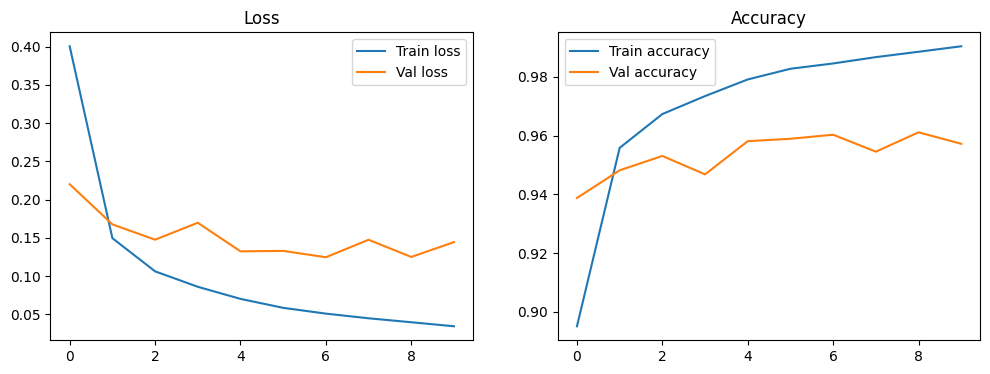

In [28]:
#pérdida y la precisión del entrenamiento y la validación
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train loss')
plt.plot(history.history['val_loss'], label='Val loss')
plt.title('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Train accuracy')
plt.plot(history.history['val_accuracy'], label='Val accuracy')
plt.title('Accuracy')
plt.legend()

plt.show()

In [29]:
model.save("plantas.h5")

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
